In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib import cm
import numpy as np
import windrose
import pandas as pd

Load QC'd datasets

In [2]:
taf = pd.read_pickle('taf_2019-2023_QC.pkl.gz')
troll = pd.read_pickle('troll_2018-2023_QC.pkl.gz')
trollOld = pd.read_pickle('trollOld_2010-2017_QC.pkl.gz')

Make hourly datasets

In [3]:
grp = taf.groupby(pd.Grouper(freq='H'))
tafG = grp.agg(['min', 'mean', 'max', 'std']).where(grp.count().min(axis=1)>45)
tafG

rh                               wd              \
                            min       mean   max       std   min        mean   
measured                                                                       
2019-01-01 00:00:00+00:00  53.0  54.783333  56.0  0.691147  33.0   45.983333   
2019-01-01 01:00:00+00:00  49.0  51.566667  54.0  1.619444  60.0   65.633333   
2019-01-01 02:00:00+00:00  49.0  50.950000  52.0  0.723105  54.0   61.266667   
2019-01-01 03:00:00+00:00  48.0  51.333333  54.0  1.385967  49.0   53.916667   
2019-01-01 04:00:00+00:00  50.0  53.450000  58.0  2.086478  49.0   57.816667   
...                         ...        ...   ...       ...   ...         ...   
2023-12-31 19:00:00+00:00  52.0  55.450000  60.0  1.943481   0.0  241.600000   
2023-12-31 20:00:00+00:00  53.0  56.800000  62.0  2.334705  22.0   44.550000   
2023-12-31 21:00:00+00:00  52.0  56.400000  61.0  2.084649  15.0   58.016667   
2023-12-31 22:00:00+00:00  55.0  59.133333  65.0  2.600304  74.0   81.150000   
2023-12-31 23:00:00+00:00  61.0  64.233333  69.0  1.750222  95.0  182.350000   

                                                 T                             \
                             max         std   min       mean   max       std   
measured                                                                        
2019-01-01 00:00:00+00:00   62.0    7.193433 -11.5 -10.895000 -10.5  0.288435   
2019-01-01 01:00:00+00:00   72.0    3.631158 -10.4  -9.556667  -8.8  0.490025   
2019-01-01 02:00:00+00:00   68.0    4.222083  -9.9  -9.473333  -8.9  0.247610   
2019-01-01 03:00:00+00:00   59.0    2.637999  -9.9  -9.373333  -8.7  0.344874   
2019-01-01 04:00:00+00:00   66.0    4.816960 -10.5  -8.958333  -8.0  0.739283   
...                          ...         ...   ...        ...   ...       ...   
2023-12-31 19:00:00+00:00  359.0  134.093466  -8.5  -7.530000  -6.9  0.417539   
2023-12-31 20:00:00+00:00   57.0    8.193476 -10.1  -9.063333  -7.8  0.708775   
2023-12-31 21:00:00+00:00   74.0   20.325730 -11.1 -10.340000  -9.3  0.533362   
2023-12-31 22:00:00+00:00   93.0    5.203731 -11.3 -10.753333 -10.0  0.297143   
2023-12-31 23:00:00+00:00  196.0   22.247319 -11.5 -10.863333 -10.1  0.370966   

                            ws                            wg                   \
                           min      mean  max       std  min       mean   max   
measured                                                                        
2019-01-01 00:00:00+00:00  4.5  6.071667  8.5  1.160084  8.9  10.580000  11.0   
2019-01-01 01:00:00+00:00  6.7  7.090000  7.7  0.294986  8.7   8.765000   9.1   
2019-01-01 02:00:00+00:00  5.6  7.421667  8.7  0.938100  9.1   9.605000   9.7   
2019-01-01 03:00:00+00:00  5.1  5.803333  7.0  0.555700  8.5   9.141667   9.7   
2019-01-01 04:00:00+00:00  4.6  5.531667  6.6  0.629094  7.7   8.321667   8.5   
...                        ...       ...  ...       ...  ...        ...   ...   
2023-12-31 19:00:00+00:00  0.0  1.531667  2.4  0.948592  3.4   3.608333   3.8   
2023-12-31 20:00:00+00:00  0.3  2.546667  4.3  1.132639  3.1   4.145000   5.4   
2023-12-31 21:00:00+00:00  1.9  5.121667  8.2  2.443330  5.4   7.495000   9.3   
2023-12-31 22:00:00+00:00  3.4  5.413333  8.2  1.243351  8.1   9.210000   9.3   
2023-12-31 23:00:00+00:00  1.9  2.805000  3.8  0.569396  5.1   6.023333   8.0   

                                     
                                std  
measured                             
2019-01-01 00:00:00+00:00  0.712075  
2019-01-01 01:00:00+00:00  0.138790  
2019-01-01 02:00:00+00:00  0.181729  
2019-01-01 03:00:00+00:00  0.525387  
2019-01-01 04:00:00+00:00  0.255841  
...                             ...  
2023-12-31 19:00:00+00:00  0.192479  
2023-12-31 20:00:00+00:00  0.937256  
2023-12-31 21:00:00+00:00  1.704473  
2023-12-31 22:00:00+00:00  0.287420  
2023-12-31 23:00:00+00:00  0.995646  

[43824 rows x 20 columns]

In [4]:
grp = troll.groupby(pd.Grouper(freq='H'))
trollG = grp.agg(['min', 'mean', 'max', 'std']).where(grp.count().min(axis=1)>45)
trollG

rh                                T            \
                            min       mean   max       std   min      mean   
measured                                                                     
2018-01-05 10:00:00+00:00   NaN        NaN   NaN       NaN   NaN       NaN   
2018-01-05 11:00:00+00:00  56.0  57.533333  59.0  0.891897  -6.6 -6.236667   
2018-01-05 12:00:00+00:00  55.0  57.033333  60.0  1.234623  -6.1 -5.673333   
2018-01-05 13:00:00+00:00  57.0  68.283333  74.0  5.452698  -6.4 -5.933333   
2018-01-05 14:00:00+00:00  62.0  68.683333  72.0  2.046010  -6.0 -5.351667   
...                         ...        ...   ...       ...   ...       ...   
2023-12-31 19:00:00+00:00  54.0  57.833333  63.0  2.179773  -8.7 -8.361667   
2023-12-31 20:00:00+00:00  49.0  53.266667  57.0  1.725842  -9.2 -8.885000   
2023-12-31 21:00:00+00:00  42.0  47.883333  52.0  3.927701  -9.2 -8.900000   
2023-12-31 22:00:00+00:00  50.0  55.150000  57.0  1.560367 -10.0 -9.605000   
2023-12-31 23:00:00+00:00  51.0  53.216667  55.0  1.222552  -9.9 -9.773333   

                                           ws                              wg  \
                           max       std  min      mean   max       std   min   
measured                                                                        
2018-01-05 10:00:00+00:00  NaN       NaN  NaN       NaN   NaN       NaN   NaN   
2018-01-05 11:00:00+00:00 -5.9  0.157272  5.2  8.010000  11.7  1.950897  16.1   
2018-01-05 12:00:00+00:00 -5.4  0.160367  2.6  4.103333   6.2  0.839283  10.5   
2018-01-05 13:00:00+00:00 -5.1  0.391289  2.0  3.366667   5.1  0.709181   5.5   
2018-01-05 14:00:00+00:00 -4.8  0.335722  1.3  2.255000   3.1  0.511371   3.7   
...                        ...       ...  ...       ...   ...       ...   ...   
2023-12-31 19:00:00+00:00 -8.0  0.182350  0.0  1.245000   2.0  0.774252   3.0   
2023-12-31 20:00:00+00:00 -8.1  0.310180  1.3  1.880000   2.6  0.374980   3.2   
2023-12-31 21:00:00+00:00 -8.5  0.183192  0.7  1.953333   3.3  0.738635   3.2   
2023-12-31 22:00:00+00:00 -8.7  0.383306  1.1  2.218333   3.6  0.634727   4.3   
2023-12-31 23:00:00+00:00 -9.7  0.068561  0.1  2.018333   3.3  0.956422   4.3   

                                                         wd              \
                                mean   max       std    min        mean   
measured                                                                  
2018-01-05 10:00:00+00:00        NaN   NaN       NaN    NaN         NaN   
2018-01-05 11:00:00+00:00  17.076667  17.1  0.138229    4.0   38.533333   
2018-01-05 12:00:00+00:00  13.716667  16.1  1.004088    4.0   62.700000   
2018-01-05 13:00:00+00:00   9.613333  10.5  1.231847    0.0  191.433333   
2018-01-05 14:00:00+00:00   5.181667   5.5  0.620413  210.0  249.400000   
...                              ...   ...       ...    ...         ...   
2023-12-31 19:00:00+00:00   3.511667   3.9  0.382716    0.0  229.283333   
2023-12-31 20:00:00+00:00   3.265000   3.3  0.048099  298.0  336.950000   
2023-12-31 21:00:00+00:00   3.670000   4.3  0.497894    0.0  301.333333   
2023-12-31 22:00:00+00:00   4.300000   4.3  0.000000  172.0  189.766667   
2023-12-31 23:00:00+00:00   4.450000   4.5  0.087333  173.0  193.850000   

                                              
                             max         std  
measured                                      
2018-01-05 10:00:00+00:00    NaN         NaN  
2018-01-05 11:00:00+00:00   51.0    9.423135  
2018-01-05 12:00:00+00:00  359.0   96.736634  
2018-01-05 13:00:00+00:00  348.0   85.371048  
2018-01-05 14:00:00+00:00  301.0   26.228591  
...                          ...         ...  
2023-12-31 19:00:00+00:00  359.0  102.882538  
2023-12-31 20:00:00+00:00  350.0   10.567659  
2023-12-31 21:00:00+00:00  360.0  101.663897  
2023-12-31 22:00:00+00:00  326.0   35.455566  
2023-12-31 23:00:00+00:00  359.0   47.514075  

[52478 rows x 20 columns]

In [5]:
grp = trollOld.groupby(pd.Grouper(freq='H'))
trollOG = grp.agg(['min', 'mean', 'max', 'std']).where(grp.count().min(axis=1)>45)
trollOG

rh                               T            \
                            min       mean   max       std  min      mean   
measured                                                                    
2010-01-01 00:00:00+00:00  62.0  65.633333  69.0  2.291966 -7.2 -6.900000   
2010-01-01 01:00:00+00:00  64.0  67.000000  69.0  1.339068 -7.1 -6.998305   
2010-01-01 02:00:00+00:00  62.0  68.600000  74.0  3.678614 -7.1 -6.855000   
2010-01-01 03:00:00+00:00  57.0  59.566667  63.0  1.169770 -6.5 -6.290000   
2010-01-01 04:00:00+00:00  56.0  58.416667  61.0  1.109156 -6.1 -5.930000   
...                         ...        ...   ...       ...  ...       ...   
2017-12-31 19:00:00+00:00  51.0  53.333333  55.0  1.052304 -6.6 -6.390000   
2017-12-31 20:00:00+00:00  50.0  53.866667  60.0  2.988490 -6.9 -6.086667   
2017-12-31 21:00:00+00:00  59.0  65.423729  70.0  2.743038 -9.3 -8.506780   
2017-12-31 22:00:00+00:00  58.0  61.816667  65.0  2.004162 -9.5 -9.123333   
2017-12-31 23:00:00+00:00  59.0  62.183333  67.0  1.827211 -9.7 -9.316667   

                                             ws                              \
                           max       std    min       mean    max       std   
measured                                                                      
2010-01-01 00:00:00+00:00 -6.6  0.174667  10.42  11.510333  13.32  0.742262   
2010-01-01 01:00:00+00:00 -6.8  0.075410  10.52  12.091111  13.15  0.709421   
2010-01-01 02:00:00+00:00 -6.5  0.183585   7.56   8.558167  10.50  0.696608   
2010-01-01 03:00:00+00:00 -6.1  0.144621   7.60  11.139000  14.20  2.093440   
2010-01-01 04:00:00+00:00 -5.7  0.122544  10.89  13.014333  15.41  1.471184   
...                        ...       ...    ...        ...    ...       ...   
2017-12-31 19:00:00+00:00 -6.1  0.179169   3.46   4.529167   5.29  0.544443   
2017-12-31 20:00:00+00:00 -5.2  0.472450   1.41   2.633559   3.88  0.808107   
2017-12-31 21:00:00+00:00 -6.7  0.645906   1.73   3.550566   4.71  0.659129   
2017-12-31 22:00:00+00:00 -8.7  0.230965   2.38   3.631167   5.77  1.131876   
2017-12-31 23:00:00+00:00 -8.5  0.310367   0.74   1.700500   2.56  0.498572   

                              wg                                 wd  \
                             min       mean    max       std    min   
measured                                                              
2010-01-01 00:00:00+00:00  10.29  14.712167  20.48  2.263834   32.7   
2010-01-01 01:00:00+00:00  10.12  14.954576  18.56  2.128052   38.5   
2010-01-01 02:00:00+00:00   6.85  10.545667  14.22  1.759484   43.9   
2010-01-01 03:00:00+00:00   5.48  14.391833  23.00  3.019626   32.9   
2010-01-01 04:00:00+00:00   9.65  17.369833  22.17  2.827313   38.3   
...                          ...        ...    ...       ...    ...   
2017-12-31 19:00:00+00:00   3.61   5.553667   7.80  1.016204   18.6   
2017-12-31 20:00:00+00:00   1.49   3.294630   5.22  1.012568    1.1   
2017-12-31 21:00:00+00:00   3.31   4.507627   5.73  0.652318  221.5   
2017-12-31 22:00:00+00:00   2.22   4.322500   7.19  1.451500  223.8   
2017-12-31 23:00:00+00:00   0.64   1.910833   3.14  0.530044  241.3   

                                                          
                                 mean    max         std  
measured                                                  
2010-01-01 00:00:00+00:00   42.165000   53.1    6.750714  
2010-01-01 01:00:00+00:00   43.492593   50.5    3.098499  
2010-01-01 02:00:00+00:00   51.506667   56.3    3.430020  
2010-01-01 03:00:00+00:00   40.970000   46.5    3.947937  
2010-01-01 04:00:00+00:00   44.005000   50.5    3.692247  
...                               ...    ...         ...  
2017-12-31 19:00:00+00:00   31.988333   42.9    6.153574  
2017-12-31 20:00:00+00:00   74.767797  345.1  104.394501  
2017-12-31 21:00:00+00:00  229.739623  246.3    5.891694  
2017-12-31 22:00:00+00:00  239.138333  254.3    9.542609  
2017-12-31 23:00:00+00:00  269.955000  307.3   20.675577  

[70128 rows x 20 colu

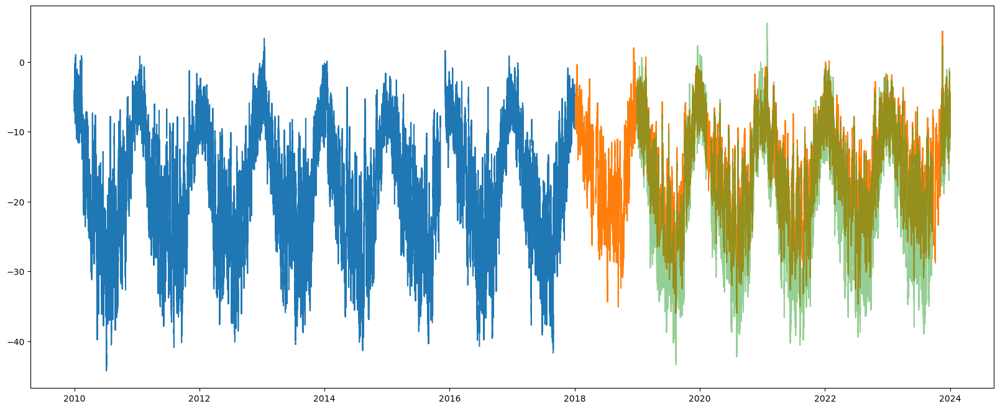

In [6]:
fig = plt.figure(figsize=(20,8))
ax = plt.subplot()
plt.plot(trollOG.index, trollOG.loc[:, 'T']['mean'])
plt.plot(trollG.index, trollG.loc[:, 'T']['mean'])
plt.plot(tafG.index, tafG.loc[:, 'T']['mean'], alpha=0.5)

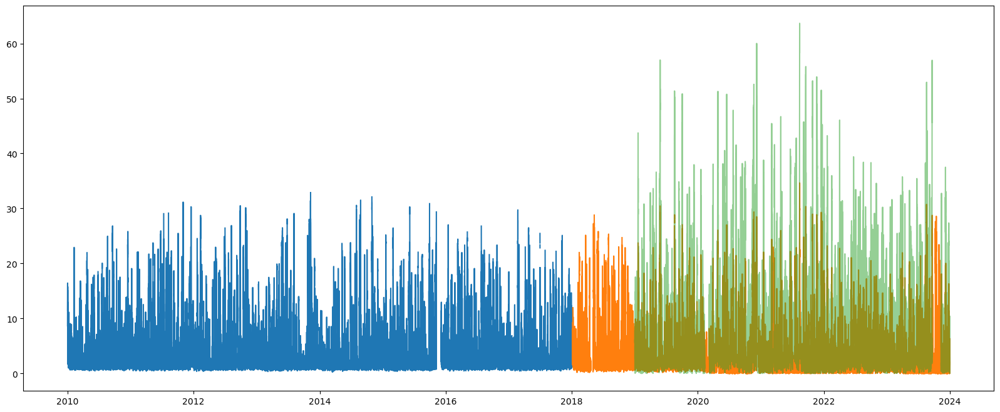

In [7]:
fig = plt.figure(figsize=(20,8))
ax = plt.subplot()
plt.plot(trollOG.index, trollOG.loc[:, 'ws']['mean'])
plt.plot(trollG.index, trollG.loc[:, 'ws']['mean'])
plt.plot(tafG.index, tafG.loc[:, 'ws']['mean'], alpha=0.5)

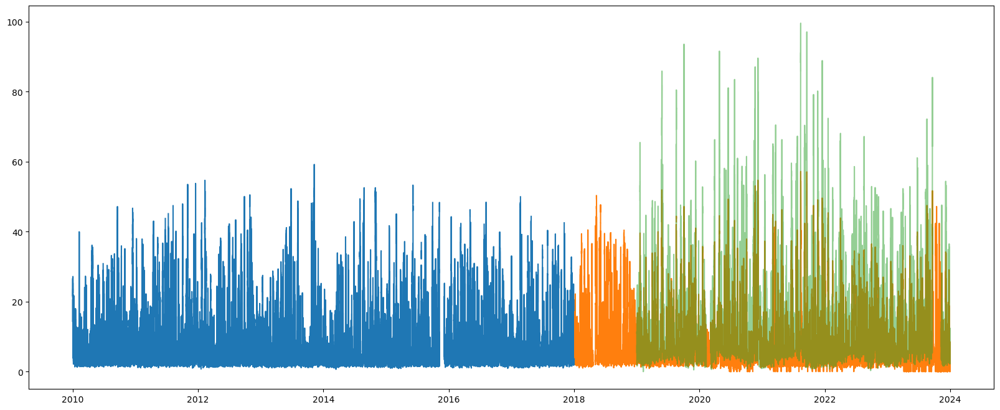

In [8]:
fig = plt.figure(figsize=(20,8))
ax = plt.subplot()
plt.plot(trollOG.index, trollOG.loc[:, 'wg']['max'])
plt.plot(trollG.index, trollG.loc[:, 'wg']['max'])
plt.plot(tafG.index, tafG.loc[:, 'wg']['max'], alpha=0.5)

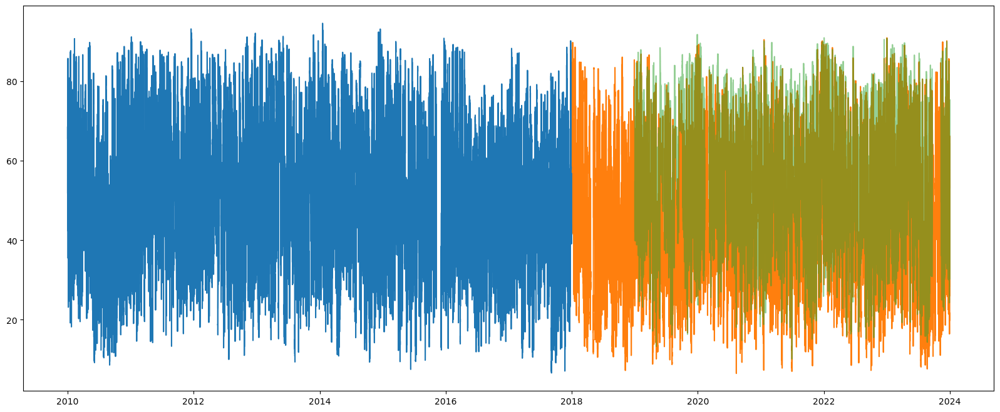

In [9]:
fig = plt.figure(figsize=(20,8))
ax = plt.subplot()
plt.plot(trollOG.index, trollOG.loc[:, 'rh']['mean'])
plt.plot(trollG.index, trollG.loc[:, 'rh']['mean'])
plt.plot(tafG.index, tafG.loc[:, 'rh']['mean'], alpha=0.5)

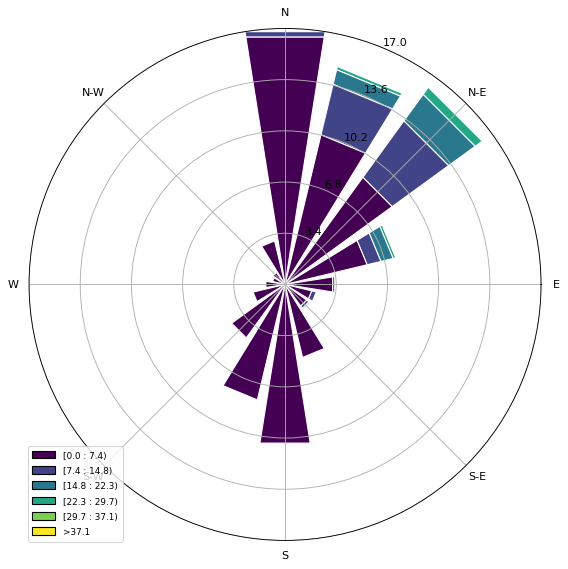

In [10]:
ax = windrose.WindroseAxes.from_ax()
ax.bar(troll.wd, troll.ws, normed=True, opening=0.8, edgecolor='white')
ax.set_legend()

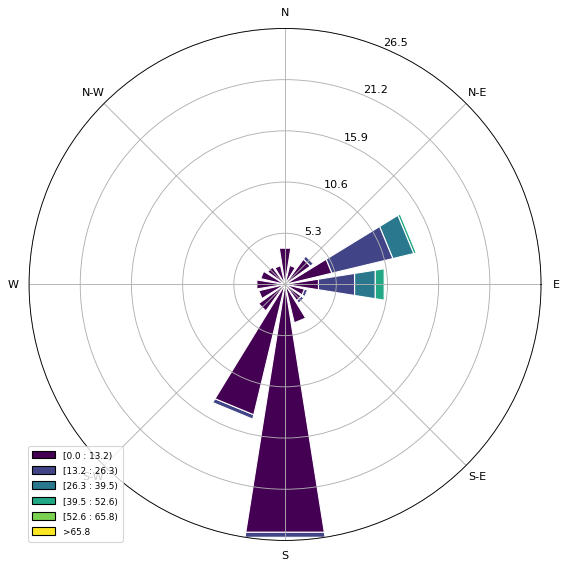

In [11]:
ax = windrose.WindroseAxes.from_ax()
ax.bar(taf.wd, taf.ws, normed=True, opening=0.8, edgecolor='white')
ax.set_legend()

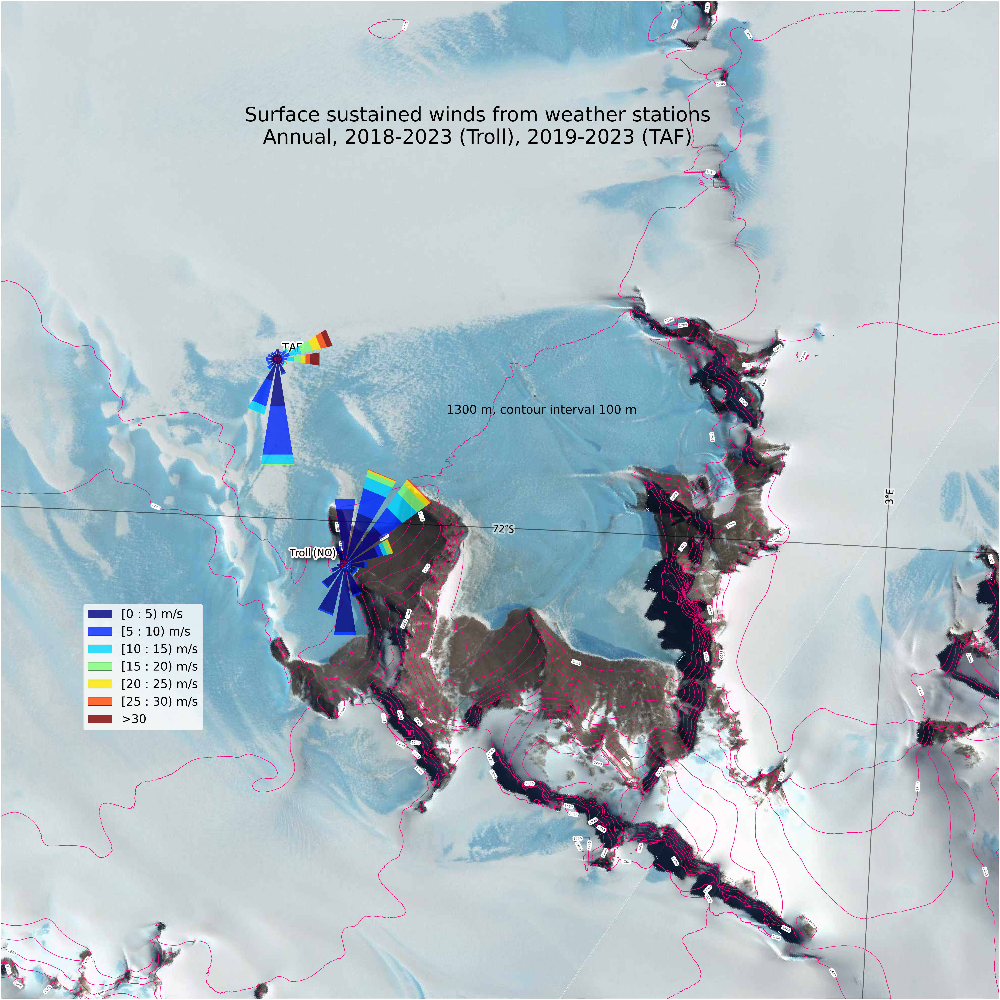

In [12]:
fig, ax = plt.subplots(figsize=(70.15, 70.15))
fname='TrollTAF_winds.png'
img = ax.imshow(plt.imread(fname))
plt.axis('off')
plt.tight_layout()
plt.text(3350, 1000, 'Surface sustained winds from weather stations\nAnnual, 2018-2023 (Troll), 2019-2023 (TAF)', ha='center', fontsize=100)
plt.text(3800, 2900, '1300 m, contour interval 100 m', ha='center', fontsize=60)

wraxTroll = inset_axes(
    ax,
    width=15,  # size in inches
    height=15,  # size in inches
    loc="center",  # center bbox at given position
    bbox_to_anchor=(2422, 3053),
    axes_class=windrose.WindroseAxes
    )
wraxTroll.bar(troll.wd, troll.ws, normed=True, opening=0.8, bins=[0.01, 5, 10, 15, 20, 25, 30], edgecolor=None, alpha=0.8, cmap=cm.jet)
wraxTroll.tick_params(labelleft=False, labelbottom=False)
wraxTroll.set_frame_on(False)
wraxTroll.grid(visible=False)

l = plt.legend(decimal_places=0, units='m/s', fontsize=60, bbox_to_anchor=(-0.75, -0.3))

wraxTaf = inset_axes(
    ax,
    width=15,  # size in inches
    height=15,  # size in inches
    loc="center",  # center bbox at given position
    bbox_to_anchor=(1950, 4495),
    axes_class=windrose.WindroseAxes
    )
wraxTaf.bar(taf.wd, taf.ws, normed=True, opening=0.8, bins=[0.01, 5, 10, 15, 20, 25, 30], edgecolor=None, alpha=0.8, cmap=cm.jet)
wraxTaf.tick_params(labelleft=False, labelbottom=False)
wraxTaf.set_frame_on(False)
wraxTaf.grid(visible=False)

fig.savefig('TrollTAF_windsYear.png')

In [13]:
season = [1, 2, 2, 3, 3, 3, 3, 3, 3, 4, 4, 1]
taf['season'] = 0
taf.loc[(taf.index.month==1) | (taf.index.month==12), 'season'] = 1
taf.loc[(taf.index.month==2) | (taf.index.month==3), 'season'] = 2
taf.loc[(taf.index.month>=4) & (taf.index.month<=9), 'season'] = 3
taf.loc[(taf.index.month==10) | (taf.index.month==11), 'season'] = 4
taf['month'] = taf.index.month

In [14]:
season = [1, 2, 2, 3, 3, 3, 3, 3, 3, 4, 4, 1]
troll['season'] = 0
troll.loc[(troll.index.month==1) | (troll.index.month==12), 'season'] = 1
troll.loc[(troll.index.month==2) | (troll.index.month==3), 'season'] = 2
troll.loc[(troll.index.month>=4) & (troll.index.month<=9), 'season'] = 3
troll.loc[(troll.index.month==10) | (troll.index.month==11), 'season'] = 4
troll['month'] = troll.index.month
troll.sample(10)

,rh,T,ws,wg,wd,season,month
measured,,,,,,,
2018-09-05 08:58:00+00:00,39.0,-23.3,1.4,1.7,51.0,3,9
2018-08-20 04:17:00+00:00,37.0,-24.6,2.0,2.6,207.0,3,8
2023-10-27 02:00:00+00:00,37.0,-19.8,0.0,0.8,359.0,4,10
2020-07-21 14:48:00+00:00,56.0,-24.8,0.7,1.7,157.0,3,7
2021-11-04 11:00:00+00:00,22.0,-11.7,4.9,6.4,334.0,4,11
2023-03-11 12:21:00+00:00,48.0,-8.3,3.5,5.5,174.0,2,3
2023-12-11 03:34:00+00:00,38.0,-8.3,0.0,0.0,0.0,1,12
2018-09-21 21:03:00+00:00,54.0,-13.8,12.3,20.7,50.0,3,9
2020-08-20 12:51:00+00:00,43.0,-26.9,0.3,2.4,2.0,3,8


In [15]:
tafM = taf.groupby(taf.month).mean()

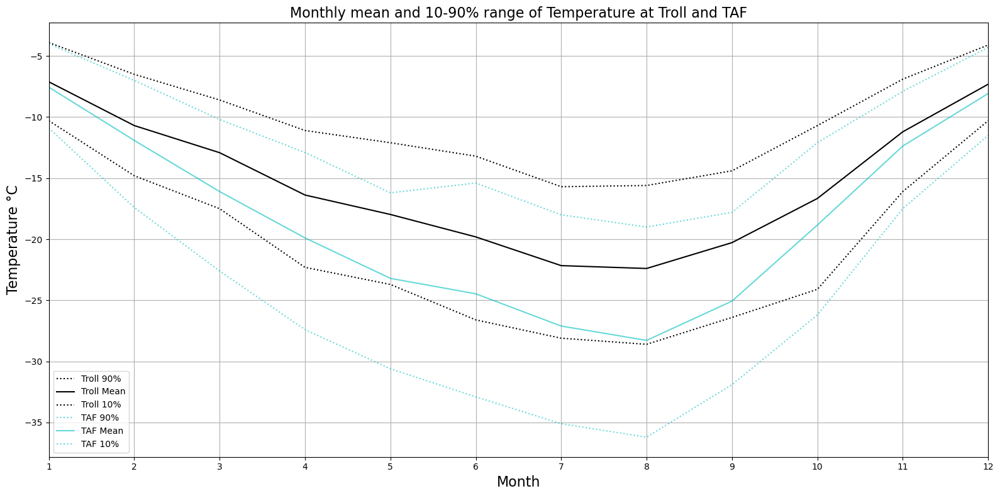

In [16]:
fig = plt.figure(figsize=(16,8))
ax = plt.subplot()
plt.plot(troll.loc[:,'T'].groupby(troll.month).mean().index, troll.loc[:,'T'].groupby(troll.month).quantile(0.9), 'k:', label='Troll 90%')
plt.plot(troll.loc[:,'T'].groupby(troll.month).mean().index, troll.loc[:,'T'].groupby(troll.month).mean(), 'k', label='Troll Mean')
plt.plot(troll.loc[:,'T'].groupby(troll.month).mean().index, troll.loc[:,'T'].groupby(troll.month).quantile(0.1), 'k:', label='Troll 10%')
plt.plot(taf.loc[:,'T'].groupby(taf.month).mean().index, taf.loc[:,'T'].groupby(taf.month).quantile(0.9), 'c:', alpha=0.6, label='TAF 90%')
plt.plot(taf.loc[:,'T'].groupby(taf.month).mean().index, taf.loc[:,'T'].groupby(taf.month).mean(), 'c', alpha=0.6, label='TAF Mean')
plt.plot(taf.loc[:,'T'].groupby(taf.month).mean().index, taf.loc[:,'T'].groupby(taf.month).quantile(0.1), 'c:', alpha=0.6, label='TAF 10%')
plt.legend()
ax.grid()
ax.set_xlabel('Month', fontsize=16)
ax.set_ylabel('Temperature °C', fontsize=16)
ax.set_xlim([1,12])
ax.set_xticks(np.arange(1,13))
ax.set_title('Monthly mean and 10-90% range of Temperature at Troll and TAF', fontsize=16)
plt.tight_layout()
fig.savefig('MonthlyT.png')

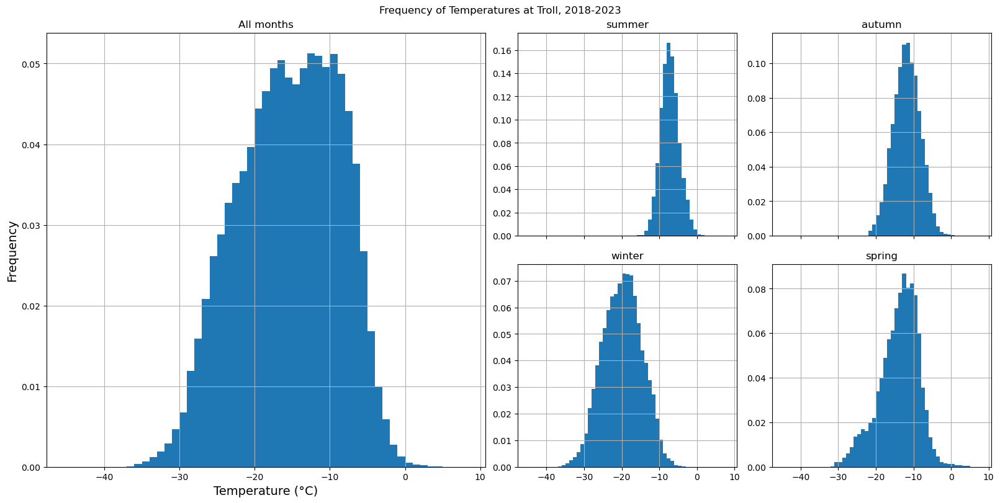

In [17]:
fig, axd = plt.subplot_mosaic([['year', 'summer', 'autumn'],
                               ['year', 'winter', 'spring']],
                              width_ratios=[2,1,1],
                              figsize=(16,8), layout='constrained', sharex=True)
fig.suptitle('Frequency of Temperatures at Troll, 2018-2023')

ax = axd['year']
troll.loc[:,'T'].hist(density=True, bins=np.arange(-45,9), ax=ax)
ax.set_title('All months')
ax.set_xlabel('Temperature (°C)', fontsize=14)
ax.set_ylabel('Frequency', fontsize=14)
#ax.set_ylim([0, 0.4])

troll.loc[troll.season==1, 'T'].hist(density=True, bins=np.arange(-45,9), ax=axd['summer'])
troll.loc[troll.season==2, 'T'].hist(density=True, bins=np.arange(-45,9), ax=axd['autumn'])
troll.loc[troll.season==3, 'T'].hist(density=True, bins=np.arange(-45,9), ax=axd['winter'])
troll.loc[troll.season==4, 'T'].hist(density=True, bins=np.arange(-45,9), ax=axd['spring'])
for s in ['summer', 'autumn', 'winter', 'spring']:
    axd[s].set_title(s)
    #axd[s].set_ylim([0, 0.4])
fig.savefig('histT.png')

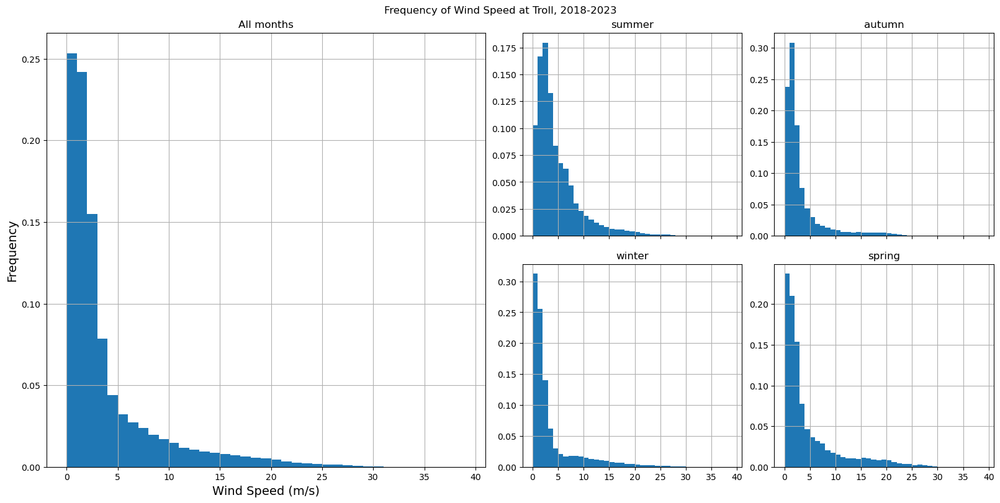

In [18]:
fig, axd = plt.subplot_mosaic([['year', 'summer', 'autumn'],
                               ['year', 'winter', 'spring']],
                              width_ratios=[2,1,1],
                              figsize=(16,8), layout='constrained', sharex=True)
fig.suptitle('Frequency of Wind Speed at Troll, 2018-2023')

ax = axd['year']
troll.loc[:,'ws'].hist(density=True, bins=np.arange(40), ax=ax)
ax.set_title('All months')
ax.set_xlabel('Wind Speed (m/s)', fontsize=14)
ax.set_ylabel('Frequency', fontsize=14)
#ax.set_ylim([0, 0.4])

troll.loc[troll.season==1, 'ws'].hist(density=True, bins=np.arange(40), ax=axd['summer'])
troll.loc[troll.season==2, 'ws'].hist(density=True, bins=np.arange(40), ax=axd['autumn'])
troll.loc[troll.season==3, 'ws'].hist(density=True, bins=np.arange(40), ax=axd['winter'])
troll.loc[troll.season==4, 'ws'].hist(density=True, bins=np.arange(40), ax=axd['spring'])
for s in ['summer', 'autumn', 'winter', 'spring']:
    axd[s].set_title(s)
    #axd[s].set_ylim([0, 0.4])
fig.savefig('histWS.png')

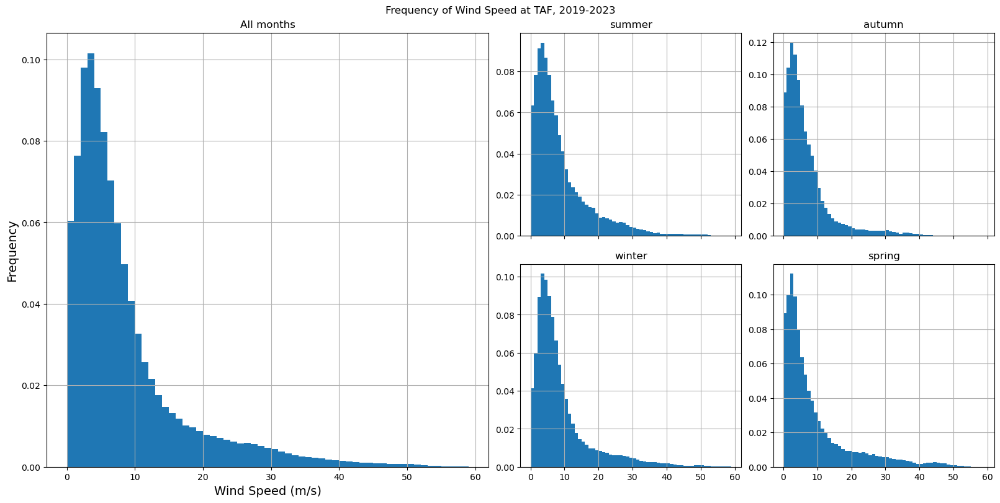

In [20]:
fig, axd = plt.subplot_mosaic([['year', 'summer', 'autumn'],
                               ['year', 'winter', 'spring']],
                              width_ratios=[2,1,1],
                              figsize=(16,8), layout='constrained', sharex=True)
fig.suptitle('Frequency of Wind Speed at TAF, 2019-2023')

ax = axd['year']
taf.loc[:,'ws'].hist(density=True, bins=np.arange(60), ax=ax)
ax.set_title('All months')
ax.set_xlabel('Wind Speed (m/s)', fontsize=14)
ax.set_ylabel('Frequency', fontsize=14)
#ax.set_ylim([0, 0.4])

taf.loc[taf.season==1, 'ws'].hist(density=True, bins=np.arange(60), ax=axd['summer'])
taf.loc[taf.season==2, 'ws'].hist(density=True, bins=np.arange(60), ax=axd['autumn'])
taf.loc[taf.season==3, 'ws'].hist(density=True, bins=np.arange(60), ax=axd['winter'])
taf.loc[taf.season==4, 'ws'].hist(density=True, bins=np.arange(60), ax=axd['spring'])
for s in ['summer', 'autumn', 'winter', 'spring']:
    axd[s].set_title(s)
    #axd[s].set_ylim([0, 0.4])
fig.savefig('histWS_TAF.png')

In [21]:
taf.describe()

,rh,wd,T,ws,wg,season,month
count,2.515602e+06,2.515376e+06,2.448001e+06,2.515324e+06,2.515553e+06,2.515726e+06,2.515726e+06
mean,5.624297e+01,1.604044e+02,-1.861823e+01,8.615071e+00,1.318805e+01,2.669717e+00,6.599153e+00
std,1.376969e+01,8.063551e+01,8.770937e+00,8.683669e+00,1.241406e+01,9.537619e-01,3.444082e+00
min,0.000000e+00,0.000000e+00,-4.780000e+01,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
25%,4.700000e+01,8.100000e+01,-2.540000e+01,3.100000e+00,5.800000e+00,2.000000e+00,4.000000e+00
50%,5.600000e+01,1.820000e+02,-1.810000e+01,5.800000e+00,8.800000e+00,3.000000e+00,7.000000e+00
75%,6.600000e+01,1.950000e+02,-1.120000e+01,1.050000e+01,1.480000e+01,3.000000e+00,1.000000e+01
max,9.500000e+01,3.600000e+02,7.200000e+00,6.580000e+01,9.960000e+01,4.000000e+00,1.200000e+01


In [22]:
troll.describe()

,rh,T,ws,wg,wd,season,month
count,3.065090e+06,3.064711e+06,3.059560e+06,3.065051e+06,3.059560e+06,3.076528e+06,3.076528e+06
mean,4.379415e+01,-1.550947e+01,3.817568e+00,7.432846e+00,1.190815e+02,2.670078e+00,6.557633e+00
std,1.586581e+01,6.691740e+00,4.865070e+00,8.195401e+00,1.054849e+02,9.439589e-01,3.436191e+00
min,4.000000e+00,-3.720000e+01,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
25%,3.200000e+01,-2.050000e+01,9.000000e-01,2.700000e+00,3.100000e+01,2.000000e+00,4.000000e+00
50%,4.200000e+01,-1.520000e+01,2.000000e+00,4.100000e+00,7.300000e+01,3.000000e+00,7.000000e+00
75%,5.400000e+01,-1.010000e+01,4.400000e+00,8.200000e+00,1.920000e+02,3.000000e+00,1.000000e+01
max,9.300000e+01,5.000000e+00,3.710000e+01,5.720000e+01,3.600000e+02,4.000000e+00,1.200000e+01


In [23]:
trollOld.describe()

,rh,T,ws,wg,wd
count,4.140946e+06,4.164665e+06,4.085572e+06,4.091011e+06,4.085572e+06
mean,5.009853e+01,-1.767751e+01,4.151783e+00,5.167739e+00,1.473309e+02
std,1.605159e+01,8.813992e+00,5.012369e+00,6.387764e+00,9.272026e+01
min,6.000000e+00,-4.490000e+01,9.000000e-02,5.000000e-02,0.000000e+00
25%,3.800000e+01,-2.450000e+01,1.260000e+00,1.510000e+00,4.740000e+01
50%,5.000000e+01,-1.710000e+01,1.910000e+00,2.390000e+00,1.927000e+02
75%,6.200000e+01,-1.030000e+01,4.800000e+00,5.880000e+00,2.254000e+02
max,9.700000e+01,4.100000e+00,3.671000e+01,5.922000e+01,3.595000e+02
